In [1]:
using LinearAlgebra
using Plots

In [500]:
## state variables
x = 0     
dx = 0
y = 0       
dy = 0

phi = 0
dphi = 0
theta = 0
dtheta = 0

## params
l = .9         # distance between center of wheel and center of base
r = 1         # radius of wheel
β1 = 1     # rotational damping on phi
β2 = 1     # rotational damping on theta
τ = 0#2       # magntiude of motor torque on wheel
F = [0;1;0]      # force on base
I = .1         # rotational inertia of wheel
m = 1         # combined mass of wheel and base
dt = 0.01
n = 1000



1000

In [501]:
ϕ_vec = zeros(n)
dϕ_vec = zeros(n)
ddϕ_vec = zeros(n)
θ_vec = zeros(n)
dθ_vec = zeros(n)
ddθ_vec = zeros(n)

x_vec = zeros(n)
dx_vec = zeros(n)
ddx_vec = zeros(n)
y_vec = zeros(n)
dy_vec = zeros(n)
ddy_vec = zeros(n)

for i in 1:n-1
    ϕ̂ = [cos(ϕ_vec[i]);sin(ϕ_vec[i]);0]
    
    #ddx_vec[i+1] = F[1]/m
    #ddy_vec[i+1] = F[2]/m
    ddθ_vec[i+1] = (1/I) * (-β2*dθ_vec[i] - dot(ϕ̂,F)*r + τ)
    ddϕ_vec[i+1] = (1/I) * (-β1*dϕ_vec[i] + l*cross(ϕ̂,F)[3])
    
    #dx_vec[i+1] = dx_vec[i] + 
    dθ_vec[i+1] = dθ_vec[i] + dt * ddθ_vec[i]
    dϕ_vec[i+1] = dϕ_vec[i] + dt * ddϕ_vec[i] 
    
    θ_vec[i+1] = θ_vec[i] + dt * dθ_vec[i]
    ϕ_vec[i+1] = ϕ_vec[i] + dt * dϕ_vec[i]
end
    


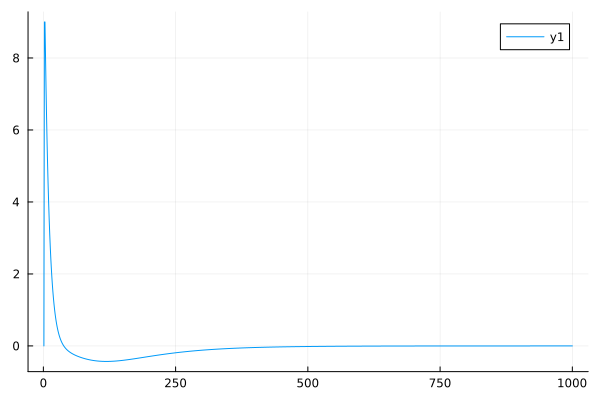

In [502]:
plot(ddϕ_vec)

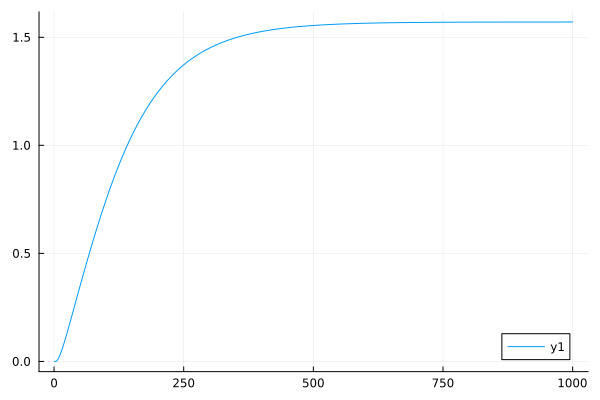

In [503]:
plot(ϕ_vec)

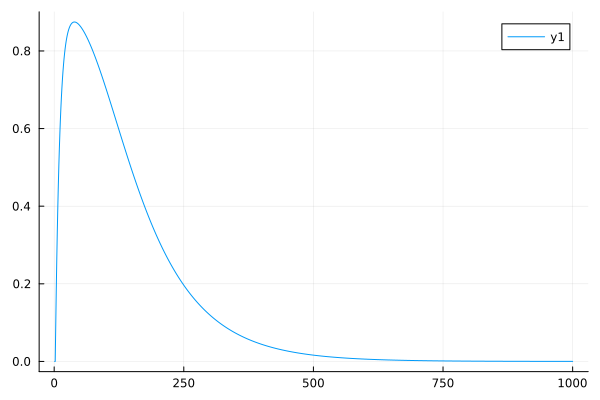

In [504]:
plot(dϕ_vec)

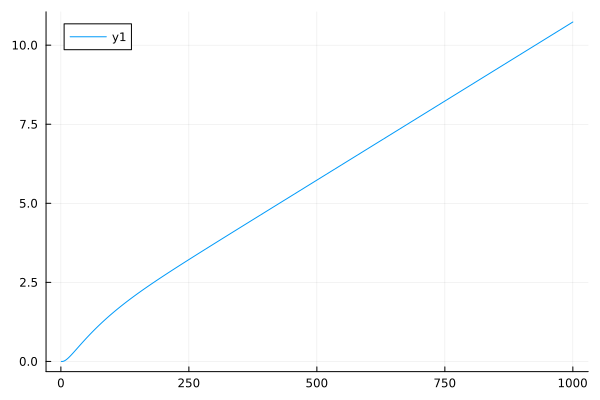

In [499]:
plot(θ_vec)

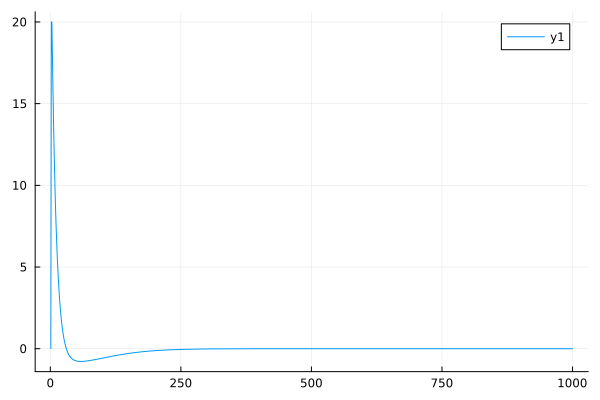

In [192]:
plot(ddθ_vec)

Now try adding a spring

In [48]:
l = .9         # distance between center of wheel and center of base
r = 1.0         # radius of wheel
β1 = 1.0     # rotational damping on phi
β2 = 1.0     # rotational damping on theta
k = 10.
τ = 1.0      # magntiude of motor torque on wheel
F = Float64[0.0;1.0;0.0]      # force on base
I = .1         # rotational inertia of wheel
m = 1         # combined mass of wheel and base
P = Float64[0.0;0.0;0.0]   # location of one end of spring
lk = 1       # resting length of spring
dt = 0.00001
n = 100000

ϕ_vec = zeros(Float64, n)
dϕ_vec = zeros(Float64, n)
ddϕ_vec = zeros(Float64, n)
θ_vec = zeros(Float64, n)
dθ_vec = zeros(Float64, n)
ddθ_vec = zeros(Float64, n)

x_vec = zeros(Float64, n)
dx_vec = zeros(Float64, n)
ddx_vec = zeros(Float64, n)
y_vec = zeros(Float64, n)
dy_vec = zeros(Float64, n)
ddy_vec = zeros(Float64, n)
f̂_vec = zeros(Float64,n)

x_vec[1] = 10.0
y_vec[1] = 10.0
f̂_vec[1] = atan(F[1],F[2])
#ϕ_vec[1] = rand()*π
ϕ_vec[1] = .1234
for i in 1:n-1
    ϕ̂ = [cos(ϕ_vec[i]);sin(ϕ_vec[i]);0]
    
    F[1] = -k * (P[1] - x_vec[i])
    F[2] = -k * (P[2] - y_vec[i])
    f̂_vec[i+1] = atan(F[1],F[2])
    ddθ_vec[i+1] = (1/I) * (-β2*dθ_vec[i] - dot(ϕ̂,F)*r + τ)
    ddϕ_vec[i+1] = (1/I) * (-β1*dϕ_vec[i] + l*cross(ϕ̂,F)[3])
    
    #dx_vec[i+1] = dx_vec[i] + 
    dθ_vec[i+1] = dθ_vec[i] + dt * ddθ_vec[i]
    dϕ_vec[i+1] = dϕ_vec[i] + dt * ddϕ_vec[i] 
    
    dx_vec[i+1] = cos(ϕ_vec[i])*r*dθ_vec[i] + sin(ϕ_vec[i])*l*dϕ_vec[i]
    dy_vec[i+1] = sin(ϕ_vec[i])*r*dθ_vec[i] - cos(ϕ_vec[i])*l*dϕ_vec[i]
    
    θ_vec[i+1] = θ_vec[i] + dt * dθ_vec[i]
    ϕ_vec[i+1] = ϕ_vec[i] + dt * dϕ_vec[i]
    x_vec[i+1] = x_vec[i] + dt * dx_vec[i]
    y_vec[i+1] = y_vec[i] + dt * dy_vec[i]
end

#add plot of F direction and ϕ direction on to trajectory

In [ ]:
plot(x_vec,y_vec)

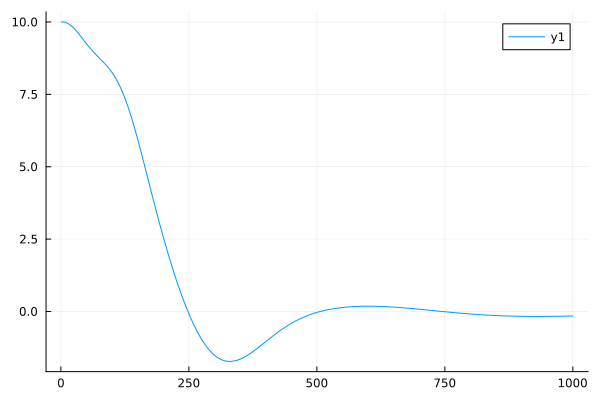

In [41]:
plot(x_vec)


In [25]:
plot(dϕ_vec)

In [26]:
plot(θ_vec)

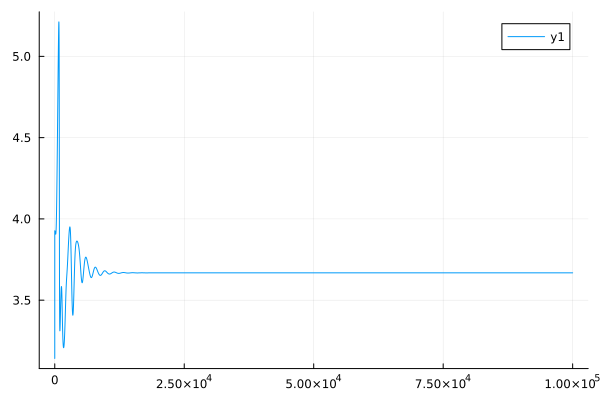

In [445]:
plot(f̂_vec.+π)

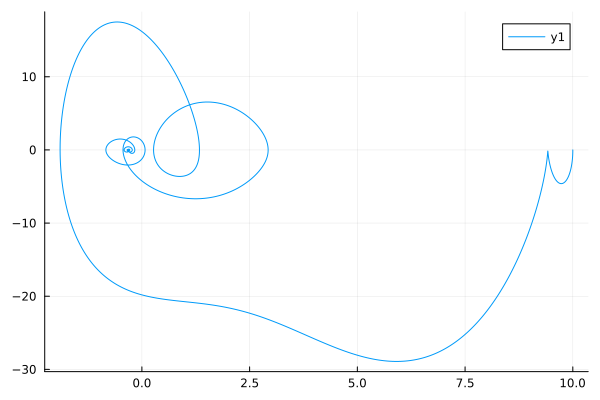

In [419]:
plot(x_vec, dx_vec)

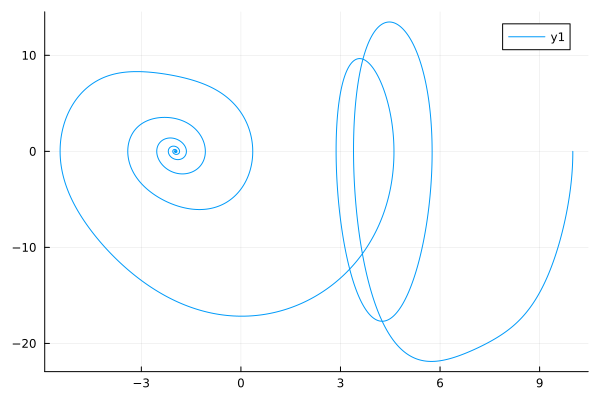

In [420]:
plot(y_vec, dy_vec)

In [421]:
ϕ_vec[n]

4.55579986924858

In [426]:
f̂_vec[n]+π*3

6.439774418315697